In [241]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [242]:
import numpy as np
import cv2

In [243]:
import cv2
from os.path import join
from IPython.display import display
from PIL import Image

from scipy import ndimage
import cancer
from cancer.visulize import show_image
from cancer.datasets import get_sipakmed
from cancer.utils import read_bmp
from cancer.variables import BASE_DATA_DIR, ABNORMAL_CELL_TYPES_SIP, NORMAL_CELL_TYPES_SIP

In [244]:
from matplotlib import pyplot as plt

In [245]:
data = get_sipakmed()

In [295]:
i = 3
img = read_bmp(data[ABNORMAL_CELL_TYPES_SIP[0]]['imgs'][i])
cells = data[ABNORMAL_CELL_TYPES_SIP[0]]['cytos'][i]

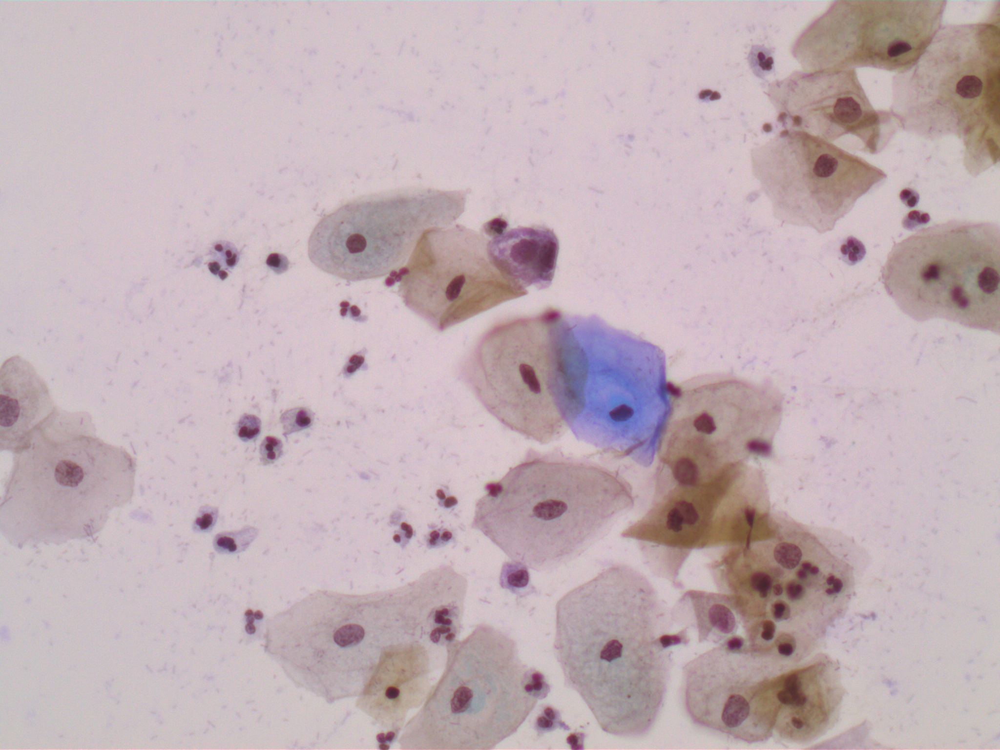

In [296]:
show_image(img)

In [297]:
i = 6
overlay_img = read_bmp(data[ABNORMAL_CELL_TYPES_SIP[0]]['imgs'][i])
overlay_cells = data[ABNORMAL_CELL_TYPES_SIP[0]]['cytos'][i]

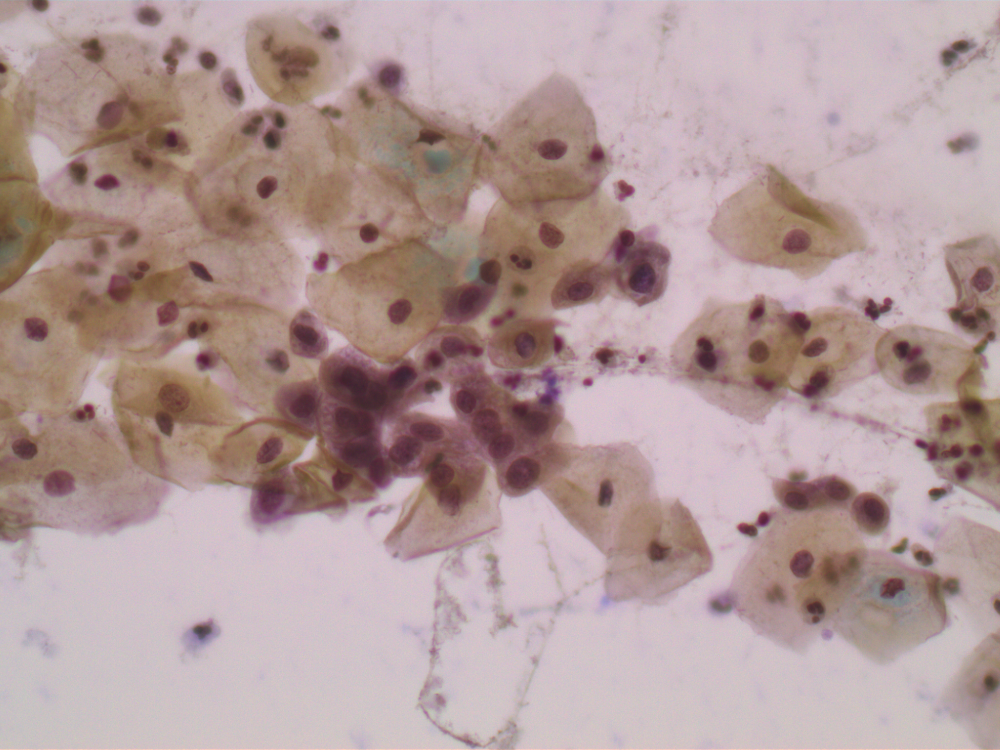

In [298]:
show_image(overlay_img)

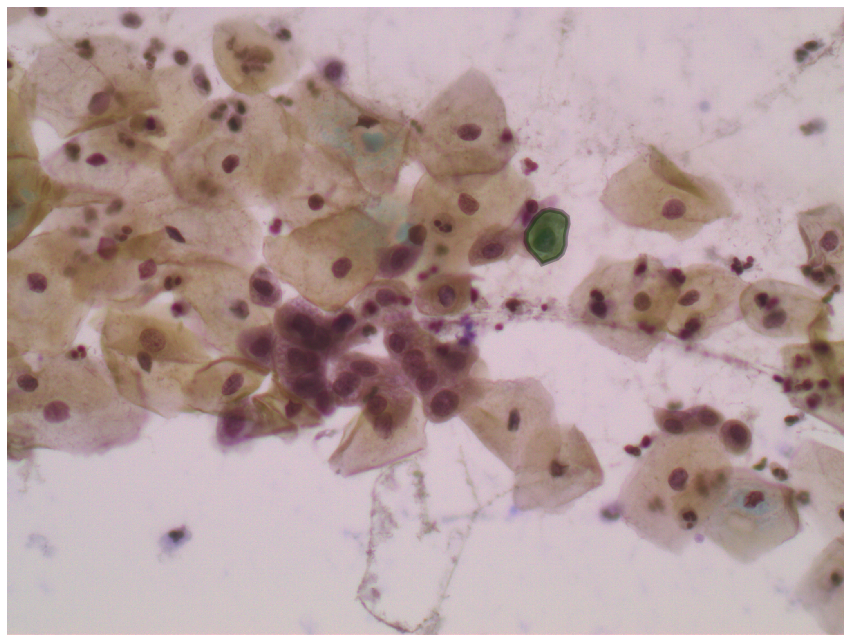

In [299]:
poly = overlay_cells[0]
cancer.visulize.plot_segment(overlay_img, [poly])

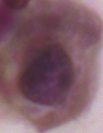

In [200]:
cropped_cell = cancer.utils.crop_cell(overlay_img, overlay_cells[0])
show_image(cropped_cell)

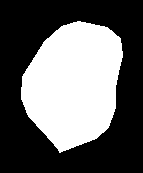

In [316]:
mask = cancer.utils.generate_mask(overlay_img, overlay_cells[0])
cropped_cell_mask = crop_cell(mask, overlay_cells[0],b=20)
show_image(cropped_cell_mask)

In [340]:
def soften_mask(mask, amount):
    kernel = np.ones((5,5), np.uint8) 
    mask_dilation = cv2.dilate(mask, kernel, iterations=amount)
    blur = cv2.GaussianBlur(mask_dilation,(21,21),0)
    return cv2.max(mask, blur)

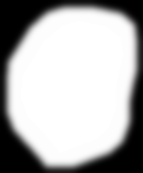

In [343]:
show_image(soften_mask(cropped_cell_mask, 7))

In [227]:
offset = (200, 100)

In [252]:
mask = np.zeros(img.shape[:2], dtype=np.uint8)
mask = place_img_on_img(mask, cropped_cell_mask, offset)
cell_img = place_img_on_img(img.copy(), cropped_cell, offset)

In [255]:
alpha = mask.astype(float)/255
alpha = np.repeat(alpha[:, :, np.newaxis], 3, axis=2)

In [259]:
fg = cv2.multiply(alpha, cell_img.astype(float))
bg = cv2.multiply(1.0 - alpha, img.astype(float))
 
outImage = cv2.add(fg, bg)

In [265]:
outImage = outImage.astype(np.uint8)

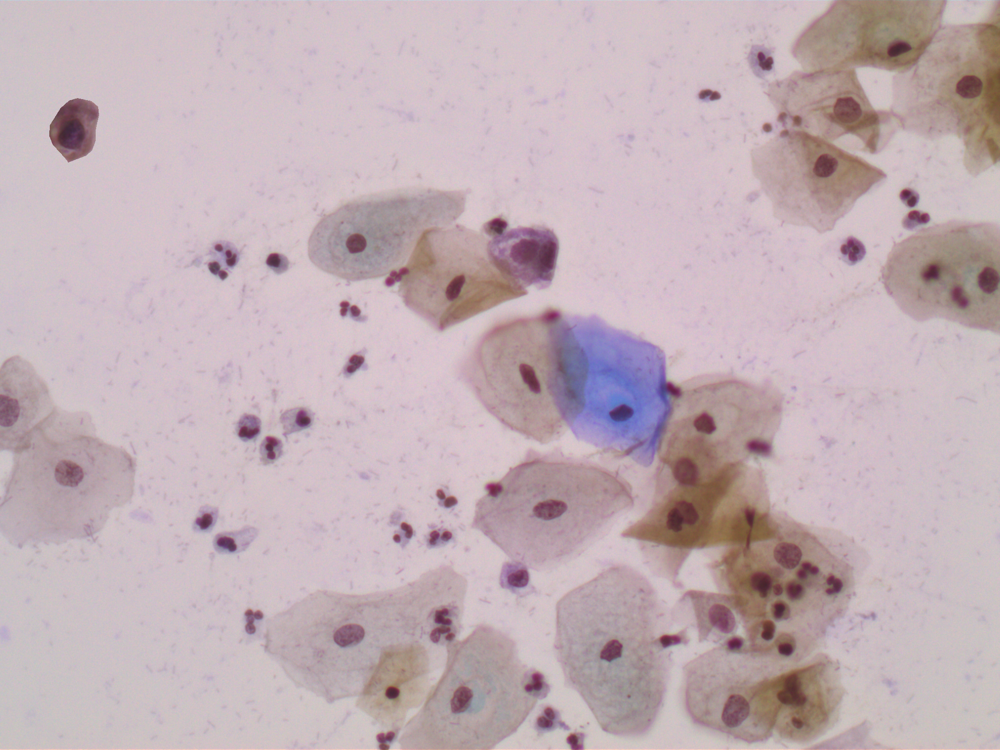

In [266]:
show_image(outImage)

In [305]:
from cancer.utils import crop_cell, generate_mask

In [306]:
poly = overlay_cells[0]
b = 4
cropped_cell = crop_cell(overlay_img, poly, b=4)
cell_mask = generate_mask(overlay_img, poly)
cropped_cell_mask = crop_cell(cell_mask, poly, b=4)

In [310]:
def image_on_image_alpha(bg, fg, fg_mask, offset):
    mask = np.zeros(img.shape[:2], dtype=np.uint8)
    mask = place_img_on_img(mask, cropped_cell_mask, offset)
    cell_img = place_img_on_img(img.copy(), cropped_cell, offset)

    alpha = mask.astype(float)/255
    alpha = np.repeat(alpha[:, :, np.newaxis], 3, axis=2)

    fg = cv2.multiply(alpha, cell_img.astype(float))
    bg = cv2.multiply(1.0 - alpha, img.astype(float))

    return cv2.add(fg, bg).astype(np.uint8)

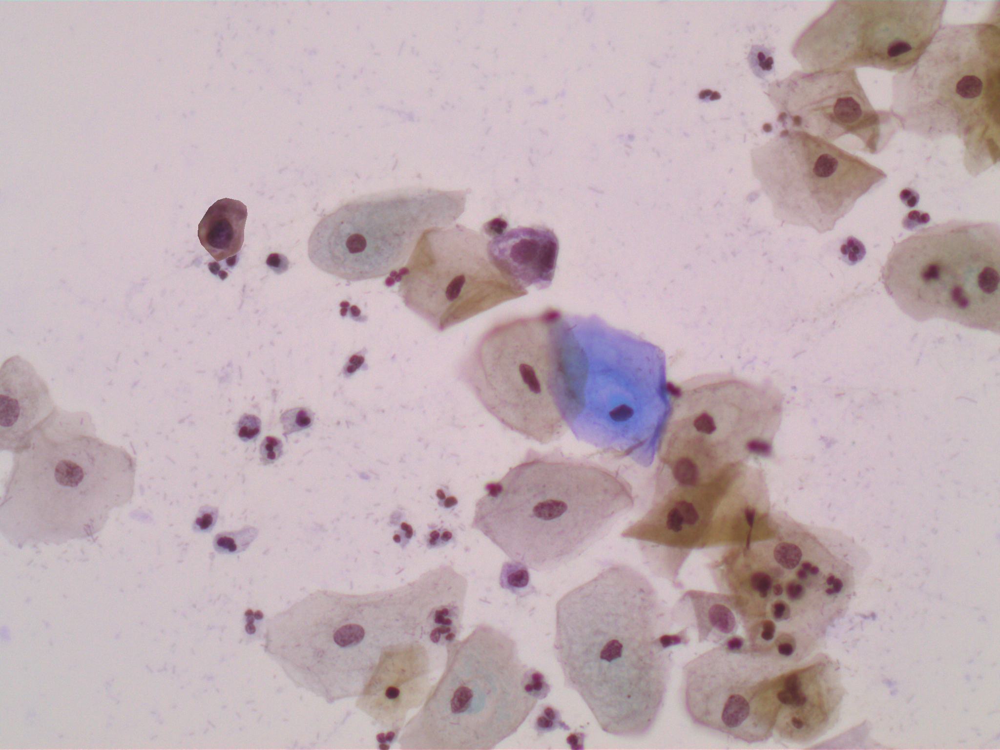

In [315]:
out = image_on_image_alpha(img, cropped_cell, cropped_cell_mask, (400, 400))
show_image(out)

In [180]:
w_offset, h_offset = 500, 50

In [181]:
cellw, cellh = cropped_cell_mask.shape

In [154]:
img[h_offset:h_offset+cellw, w_offset:w_offset+cellh] = fg

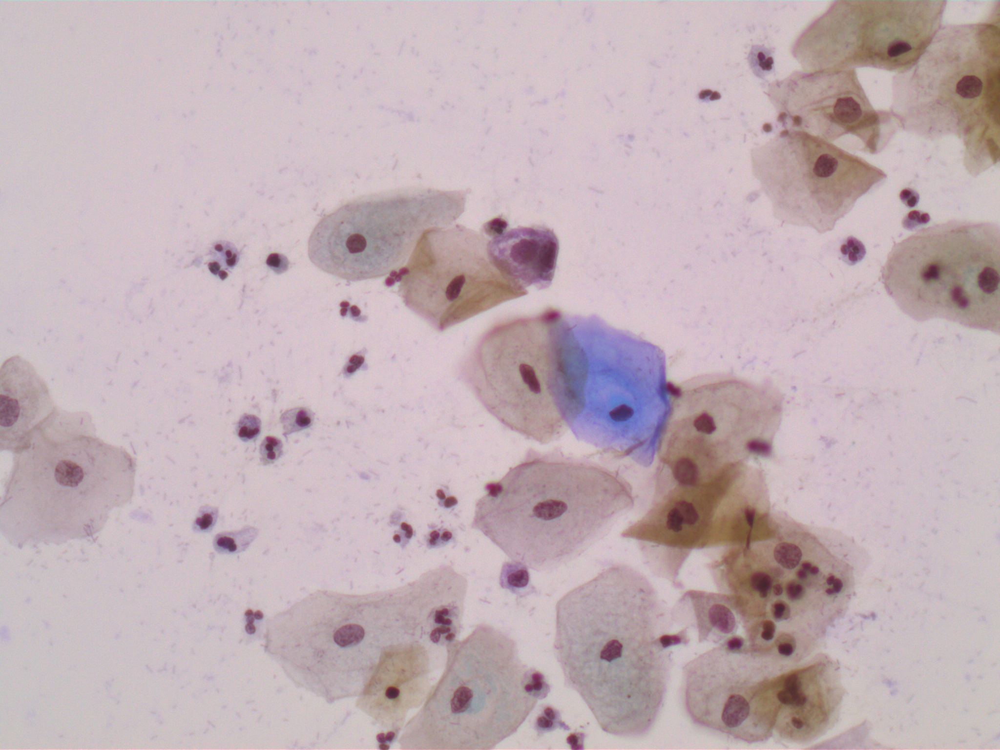

In [182]:
show_image(img)

## Test Insert

In [349]:
i = 3
base_img = read_bmp(data[ABNORMAL_CELL_TYPES_SIP[0]]['imgs'][i])
base_cells = data[ABNORMAL_CELL_TYPES_SIP[0]]['cytos'][i]

j = 6
overlay_img = read_bmp(data[ABNORMAL_CELL_TYPES_SIP[0]]['imgs'][j])
overlay_cells = data[ABNORMAL_CELL_TYPES_SIP[0]]['cytos'][j]
cell_poly = overlay_cells[0]

ans = cancer.utils.add_cell(base_img, overlay_img, cell_poly, (100,100), b=40)

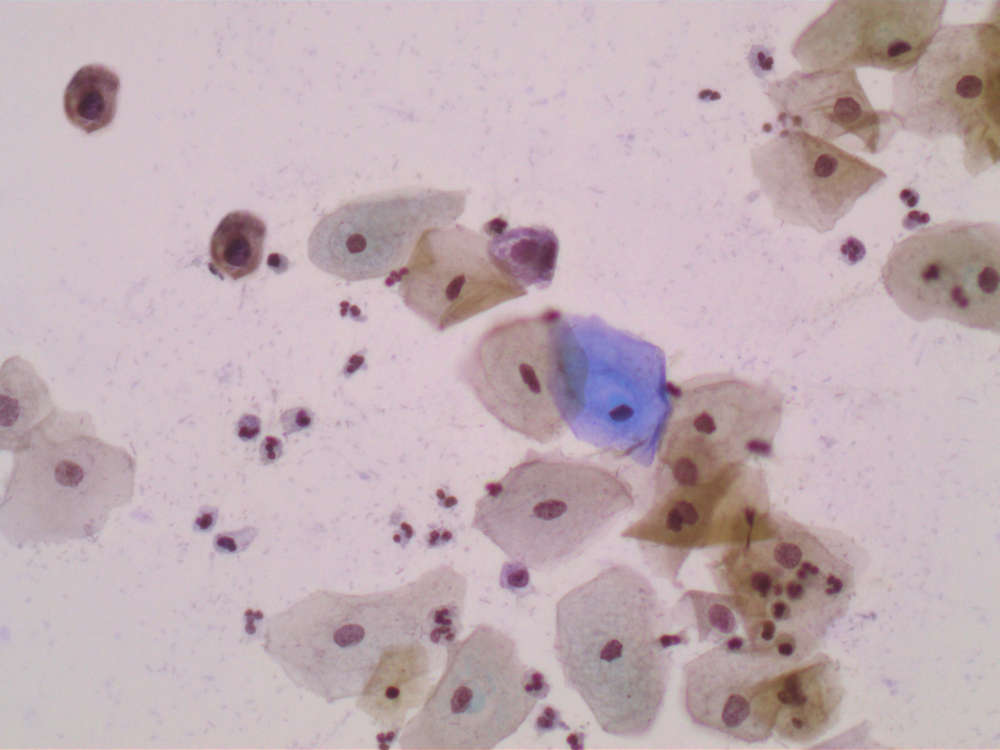

In [353]:
show_image(ans)

In [352]:
ans = cancer.utils.add_cell(ans, overlay_img, cell_poly, (400,400), b=40)

In [137]:
cW, cH = cancer.utils.image_center(cropped_cell)

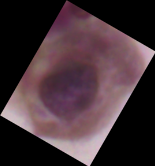

In [135]:
a = cancer.utils.rotate_bound(cropped_cell, 30)
show_image(a)

## Overlay

In [15]:
sipakmed = get_sipakmed()

In [17]:
sipakmed.keys()

dict_keys(['metaplastic', 'dyskeratotic', 'superficial-intermediate', 'parabasal', 'koilocytotic'])

In [38]:
h, w, _ = img1.shape
mask = np.zeros((h,w,3), np.uint8)

In [39]:
mask = cv2.rectangle(mask,(384,200),(510,128),(255,255,255),-1)

In [41]:
def overlay_image_alpha(img, img_overlay, pos, alpha_mask):
    """Overlay img_overlay on top of img at the position specified by
    pos and blend using alpha_mask.

    Alpha mask must contain values within the range [0, 1] and be the
    same size as img_overlay.
    """

    x, y = pos

    # Image ranges
    y1, y2 = max(0, y), min(img.shape[0], y + img_overlay.shape[0])
    x1, x2 = max(0, x), min(img.shape[1], x + img_overlay.shape[1])

    # Overlay ranges
    y1o, y2o = max(0, -y), min(img_overlay.shape[0], img.shape[0] - y)
    x1o, x2o = max(0, -x), min(img_overlay.shape[1], img.shape[1] - x)

    # Exit if nothing to do
    if y1 >= y2 or x1 >= x2 or y1o >= y2o or x1o >= x2o:
        return

    channels = img.shape[2]

    alpha = alpha_mask[y1o:y2o, x1o:x2o]
    alpha_inv = 1.0 - alpha

    for c in range(channels):
        img[y1:y2, x1:x2, c] = (alpha * img_overlay[y1o:y2o, x1o:x2o, c] +
                                alpha_inv * img[y1:y2, x1:x2, c])

In [43]:
img1 = cv2.cvtColor(img1, cv2.COLOR_RGB2RGBA).copy()
mask = cv2.cvtColor(mask, cv2.COLOR_RGB2RGBA).copy()

overlay_image_alpha(img1, mask, (0,0), mask)

ValueError: operands could not be broadcast together with shapes (1536,2048,4) (1536,2048) 

In [44]:
img1

array([[[ 58,  85, 106, 255],
        [ 58,  85, 106, 255],
        [ 59,  86, 109, 255],
        ...,
        [118, 157, 146, 255],
        [117, 156, 147, 255],
        [120, 150, 151, 255]],

       [[ 66,  80,  96, 255],
        [ 73,  70, 103, 255],
        [ 74,  69, 100, 255],
        ...,
        [132, 142, 145, 255],
        [125, 145, 146, 255],
        [123, 150, 141, 255]],

       [[ 63,  75,  87, 255],
        [ 69,  70,  91, 255],
        [ 69,  65,  93, 255],
        ...,
        [133, 143, 139, 255],
        [131, 144, 138, 255],
        [127, 148, 134, 255]],

       ...,

       [[103,  90,  98, 255],
        [108,  89,  98, 255],
        [109,  91,  95, 255],
        ...,
        [156, 164, 148, 255],
        [153, 164, 150, 255],
        [152, 163, 154, 255]],

       [[110,  83,  97, 255],
        [111,  90,  92, 255],
        [110,  86,  91, 255],
        ...,
        [173, 170, 146, 255],
        [170, 167, 148, 255],
        [168, 173, 147, 255]],

       [[110

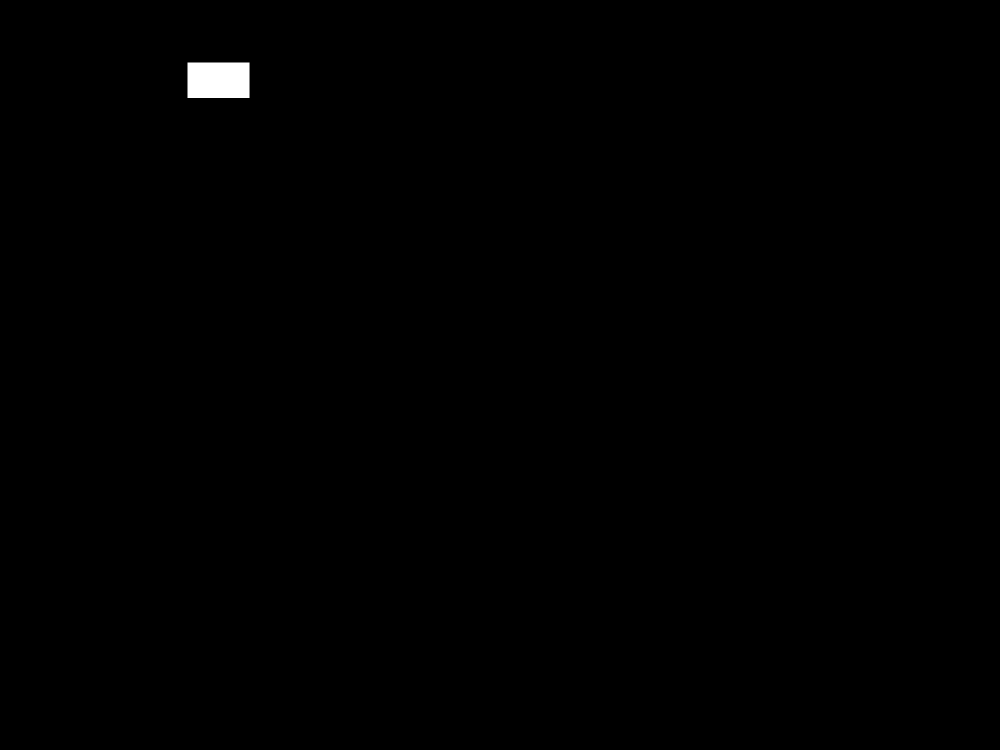

In [40]:
show_image(mask)

In [25]:
s_img = cv2.imread("smaller_image.png", -1)

y1, y2 = y_offset, y_offset + s_img.shape[0]
x1, x2 = x_offset, x_offset + s_img.shape[1]

alpha_s = s_img[:, :, 3] / 255.0
alpha_l = 1.0 - alpha_s

for c in range(0, 3):
    alpha = s_img[oy:oy+height, ox:ox+width, 3] / 255.0
    color = s_img[oy:oy+height, ox:ox+width, c] * (1.0-alpha)
    beta  = l_img[by:by+height, bx:bx+width, c] * (alpha)

    l_img[by:by+height, bx:bx+width, c] = color + beta

NameError: name 'y_offset' is not defined